<a href="https://colab.research.google.com/github/Ishushan02/Face-Recognition-using-Transfer-Learning/blob/main/Face_Recognition_using_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**This Notebook is an example of Image Classification using Transfer Learning, I have used the faces of "Bill_Gates", "Jack_maa", "Modi", "Musk", "Trump", and a negative face  "Unknown" to give a better accuracy so that the model doesnot predict the Wrong Faces.** 

**I have made my own Dataset, and downloaded the Images from Google and some from Kaggle. The Procedure to Create Dataset :**

  **1: Download the Images of Specific Preson from Google or Kaggle.**  

  **2: Apply MTCNN Face Detecting Algorithm on each images and crop each face from the Image using OpenCV.**
  
  **3: Save the Cropped Faces in to corresponding Directories using OpenCV as shown below**

              -Train
                 |- Bill_gates
                 |- Jack_Maa
                 |- Narendra_Modi
                 |- Elon_Musk
                 |- Donald_Trump
                 |- Unknown_Faces
              -Test
                 |- Bill_gates
                 |- Jack_Maa
                 |- Narendra_Modi
                 |- Elon_Musk
                 |- Donald_Trump
                 |- Unknown_Faces
     
     
  **4: The folder should be assigned as the above Format so that it can be coorectly accessed by the Image Generator.**
     **5: Do this all precodure locally on the Computer and than save the dataset.**
 
 **Finally After preparation of Dataset, you can train the Model locally  if you have enabled GPU or else train in on GOogle Colab by using below code.**



Importing the Required Libraries

In [ ]:
import tensorflow
from tensorflow import keras
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import pathlib
import matplotlib.pyplot as plt
import cv2
import os           

Importing Drive to Acess the Data File

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


Assigning the Training and Testing Diretory

In [ ]:
training_dir = '/content/drive/MyDrive/Face_Recognition/training_images'
testing_dir = '/content/drive/MyDrive/Face_Recognition/testing_images'

In [ ]:
training_dir

'/content/drive/MyDrive/Face_Recognition/training_images'

In [ ]:
testing_dir

'/content/drive/MyDrive/Face_Recognition/testing_images'

In [ ]:
training_dir = pathlib.Path(r'/content/drive/MyDrive/Face_Recognition/training_images')
testing_dir = pathlib.Path(r'/content/drive/MyDrive/Face_Recognition/testing_images')

In [ ]:
print(list(training_dir.glob('0/*.jpg'))[:5])
print(list(testing_dir.glob('0/*.jpg'))[:5])

[PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg10.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg21.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg31.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg32.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg33.jpg')]
[PosixPath('/content/drive/MyDrive/Face_Recognition/testing_images/0/bg1.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/testing_images/0/bg11.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/testing_images/0/bg14.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/testing_images/0/bg12.jpg'), PosixPath('/content/drive/MyDrive/Face_Recognition/testing_images/0/bg16.jpg')]


In [ ]:
len(list(training_dir.glob('0/*.jpg')))

158

In [ ]:
list(training_dir.glob('0/*.jpg'))[0]

PosixPath('/content/drive/MyDrive/Face_Recognition/training_images/0/bg10.jpg')

Image Augmentation and Normalization using ImageGenerator

In [ ]:
tr_genr = ImageDataGenerator(rescale = 1 / 255,
                              rotation_range=20,
                              width_shift_range=0.1,
                              height_shift_range=0.1,
                              horizontal_flip=True,
                              fill_mode='nearest')
ts_genr = ImageDataGenerator(rescale = 1 / 255)

In [ ]:
training_generator = tr_genr.flow_from_directory(training_dir,
                                                 target_size = (150, 150), 
                                                 class_mode = 'categorical')
testing_generator = ts_genr.flow_from_directory(testing_dir,
                                                target_size = (150, 150),
                                                class_mode = 'categorical')

Found 1305 images belonging to 6 classes.
Found 173 images belonging to 6 classes.


Visualization of Training and Testing Dataset

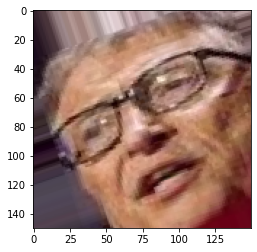

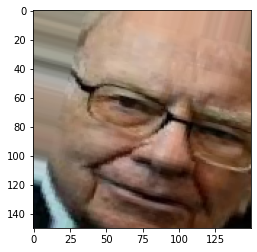

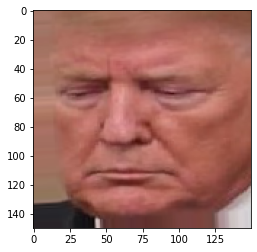

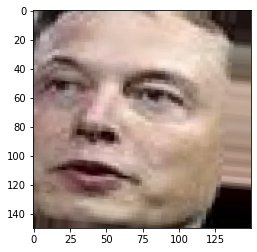

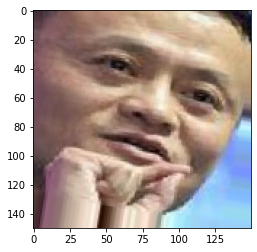

In [ ]:
x,y = training_generator.next()
for i in range(0,5):
     image = x[i]
     plt.imshow(image)
     plt.show()

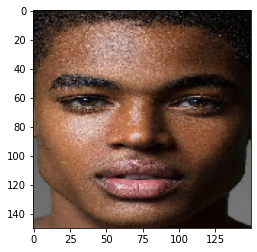

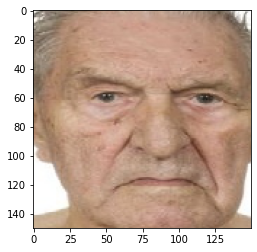

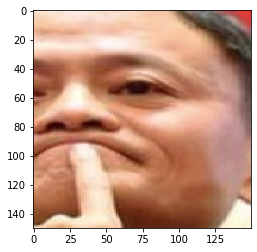

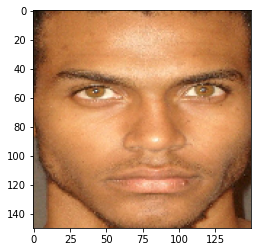

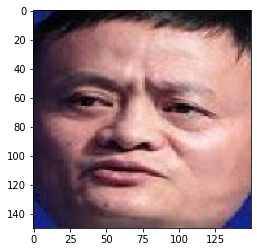

In [ ]:
x,y = testing_generator.next()
for i in range(0,5):
    image = x[i]
    plt.imshow(image)
    plt.show()

In [ ]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras import layers
from tensorflow.keras.applications.inception_v3 import InceptionV3

Assigning Directory of Pretrained Weight of Inception V3 model 

In [ ]:
local_pretrained_weight_file = "/content/drive/MyDrive/Face_Recognition/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5"

Loading the Model with removing the Top layers so that we will add our own 5 Output Layers

In [ ]:
pretrained_model = InceptionV3(input_shape = (150, 150, 3), include_top = False, weights = None)

Loading the Weight of the Model

In [ ]:
pretrained_model.load_weights(local_pretrained_weight_file)

Frezzing th Model

In [ ]:
for layer in pretrained_model.layers:
    layer.trainable = False

Model Summary

In [ ]:
pretrained_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 150, 150, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 74, 74, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 74, 74, 32)   96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 74, 74, 32)   0           batch_normalization[0][0]        
_______________________________________________________________________________________

Extracting out the last Layer of Pretrained Model and giving it as an input to my Model

In [ ]:
out_layer = pretrained_model.get_layer('mixed10')
output_layer = out_layer.output
output_layer

<KerasTensor: shape=(None, 3, 3, 2048) dtype=float32 (created by layer 'mixed10')>

Creating my Model adding dropout layers in between to remove the Overfitting

In [ ]:
x = layers.Flatten()(output_layer)
x = layers.Dense(2048, activation = 'relu')(x)
x = layers.Dense(1024, activation = 'relu')(x)
x = layers.Dense(1024, activation = 'relu')(x)
x = layers.Dense(512, activation = 'relu')(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(256, activation = 'relu')(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(128, activation = 'relu')(x)
x = layers.Dropout(0.35)(x)
x = layers.Dense(64, activation = 'relu')(x)
x = layers.Dropout(0.35)(x)
x = layers.Dense(28, activation = 'relu')(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(6, activation = 'softmax')(x) #sigmoid

model = Model(pretrained_model.input, x)
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001),
              loss = 'categorical_crossentropy', 
              metrics = ['accuracy'])

Training the Model and Adding a Callback function which stops the training if the Validation Accuracy increases more than 95%.

In [ ]:
class myCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if(logs['val_accuracy']>0.95):
            print("\n Reached 95.0% accuracy so cancelling training!")
            self.model.stop_training = True

callbacks = myCallback()

history = model.fit(
      training_generator,
      epochs=500,
      callbacks = [callbacks],
      validation_data=testing_generator)#120

Epoch 1/500
41/41 [==============================] - 13s 306ms/step - loss: 0.3708 - accuracy: 0.8774 - val_loss: 0.5447 - val_accuracy: 0.8728
Epoch 2/500
41/41 [==============================] - 13s 303ms/step - loss: 0.4422 - accuracy: 0.8774 - val_loss: 0.4288 - val_accuracy: 0.8728
Epoch 3/500
41/41 [==============================] - 13s 309ms/step - loss: 0.3546 - accuracy: 0.8912 - val_loss: 0.4520 - val_accuracy: 0.8902
Epoch 4/500
41/41 [==============================] - 13s 305ms/step - loss: 0.3023 - accuracy: 0.9042 - val_loss: 0.3708 - val_accuracy: 0.9075
Epoch 5/500
41/41 [==============================] - 12s 302ms/step - loss: 0.3710 - accuracy: 0.8797 - val_loss: 0.4957 - val_accuracy: 0.8728
Epoch 6/500
41/41 [==============================] - 12s 304ms/step - loss: 0.2800 - accuracy: 0.9264 - val_loss: 0.7058 - val_accuracy: 0.8555
Epoch 7/500
41/41 [==============================] - 13s 306ms/step - loss: 0.3153 - accuracy: 0.9096 - val_loss: 0.4882 - val_accuracy:

Interpretting the Graphs of Training and Validation Accuracies

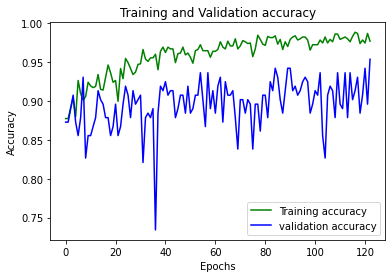

In [ ]:
import matplotlib.pyplot as plt
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
epochs = range(len(acc))
plt.plot(epochs, acc, 'g', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Interpretting the Graph od Training and Validation Losses

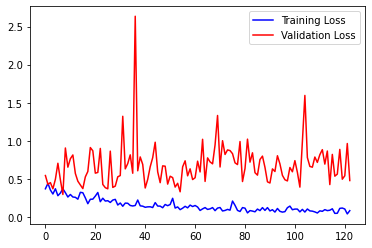

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(loss))
plt.plot(epochs, loss, 'b', label = 'Training Loss')
plt.plot(epochs, val_loss, 'r', label = 'Validation Loss')
plt.legend()

Predicting the Model

In [ ]:
from sklearn.metrics import classification_report
predicted = model.predict_generator(testing_generator)
predicted

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


array([[1.2487653e-01, 4.7442994e-01, 2.2813113e-01, 8.9100063e-01,
        3.4952059e-01, 5.0342852e-01],
       [8.2818991e-01, 4.1302576e-13, 1.0000000e+00, 1.0000000e+00,
        9.9958831e-01, 9.9985528e-01],
       [2.7838515e-03, 9.3329626e-01, 6.8147754e-04, 2.9604453e-01,
        1.0000000e+00, 1.0065497e-03],
       ...,
       [9.7833472e-01, 2.0923525e-01, 2.6029665e-02, 1.9541783e-02,
        1.1277544e-01, 1.0000000e+00],
       [8.8159451e-03, 8.9154541e-01, 2.3904890e-03, 3.2646209e-01,
        1.0000000e+00, 3.7177943e-03],
       [1.7907043e-08, 1.9332156e-01, 4.0851817e-05, 1.0000000e+00,
        4.8797480e-03, 1.0811987e-01]], dtype=float32)

In [ ]:
y_predict = []
for i in predicted:
  y_predict.append(np.argmax(i))

In [ ]:
len(y_predict)

173

In [ ]:
y_predict

[0,
 0,
 3,
 4,
 1,
 5,
 1,
 1,
 5,
 3,
 0,
 3,
 4,
 3,
 5,
 5,
 5,
 5,
 3,
 2,
 2,
 4,
 2,
 4,
 3,
 5,
 4,
 1,
 4,
 1,
 0,
 0,
 5,
 4,
 5,
 1,
 5,
 2,
 0,
 3,
 4,
 5,
 4,
 3,
 5,
 5,
 3,
 4,
 4,
 1,
 2,
 2,
 5,
 3,
 1,
 2,
 2,
 4,
 0,
 0,
 5,
 5,
 5,
 5,
 1,
 0,
 2,
 1,
 2,
 5,
 1,
 0,
 3,
 5,
 0,
 2,
 1,
 2,
 3,
 5,
 0,
 0,
 0,
 2,
 2,
 4,
 4,
 3,
 5,
 5,
 3,
 2,
 4,
 3,
 4,
 5,
 4,
 4,
 5,
 5,
 3,
 4,
 1,
 5,
 0,
 0,
 3,
 0,
 1,
 0,
 5,
 2,
 2,
 3,
 5,
 5,
 3,
 1,
 2,
 0,
 1,
 1,
 0,
 5,
 4,
 2,
 4,
 0,
 2,
 5,
 0,
 1,
 0,
 1,
 5,
 1,
 4,
 4,
 2,
 5,
 3,
 4,
 2,
 1,
 1,
 4,
 0,
 1,
 4,
 5,
 0,
 5,
 1,
 4,
 5,
 5,
 2,
 3,
 4,
 5,
 2,
 3,
 3,
 4,
 5,
 2,
 1,
 3,
 5,
 2,
 1,
 0,
 5]

In [ ]:
y_predicted

[0.4145885407924652, 0.9653179049491882]

Assing the class Names of 5 People on which the model is trained

In [ ]:
classes = ["Bill_Gates", "Jack_maa", "Modi", "Musk", "Trump", "Unknown"]
#classes = ["Bg", "Jm", "Mo", "Mu", "Tp", "Un"]

MTCNN is used to detect the human face so, its pixels can be sent to predict the face

In [ ]:
!pip install mtcnn

     |████████████████████████████████| 2.3MB 10.9MB/s 


In [ ]:
from mtcnn.mtcnn import MTCNN
detector = MTCNN()

Assigning the Directory from drive to test new Images

In [ ]:
new_images = pathlib.Path(r'/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing')
list(new_images.glob('00/*.jpg'))[:5]

[PosixPath('/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing/00/im7.jpg'),
 PosixPath('/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing/00/im2.jpg'),
 PosixPath('/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing/00/im3.jpg'),
 PosixPath('/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing/00/im4.jpg'),
 PosixPath('/content/drive/MyDrive/Face_Recognition/New_Images_for_Testing/00/test1.jpg')]

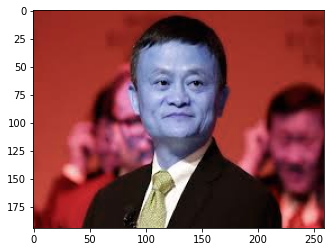

In [ ]:
image = cv2.imread(str(list(new_images.glob('00/*.jpg'))[10]))
plt.imshow(image)

Predicting the Faces with atmost Accuracy 

[[1.0428776e-09 4.4052296e-14 2.1007198e-13 7.8191800e-11 3.2278149e-13
  1.0000000e+00]]
[[1.6919737e-08 2.8622517e-12 1.1894835e-11 1.8250084e-09 1.5984925e-11
  1.0000000e+00]]
[[8.2296498e-07 8.9268343e-10 2.4873190e-09 1.4867710e-07 3.3676093e-09
  9.9999905e-01]]
[[3.4452730e-04 6.6287985e-06 1.3613973e-05 1.5930219e-04 1.5907819e-05
  9.9945992e-01]]
[[4.2417747e-04 9.3374856e-06 1.6476859e-05 1.5741945e-04 2.0009322e-05
  9.9937254e-01]]
[[6.2431171e-12 2.7011303e-17 1.6910925e-16 2.4234588e-13 2.8682301e-16
  1.0000000e+00]]
[[4.0018171e-09 3.2520267e-13 1.5361407e-12 3.5050690e-10 2.1461986e-12
  1.0000000e+00]]
[[0.01960727 0.00352456 0.00478133 0.01460558 0.00450506 0.95297617]]
[[5.0255267e-07 4.1442286e-10 1.2980644e-09 7.7156315e-08 1.7383015e-09
  9.9999940e-01]]
[[1.5778987e-05 7.6385561e-08 1.8811905e-07 4.6649807e-06 2.2482654e-07
  9.9997902e-01]]
[[1.8603192e-12 4.0843867e-18 2.7802371e-17 6.0976757e-14 5.1850007e-17
  1.0000000e+00]]
[[1.6337654e-06 2.3771469e-09 

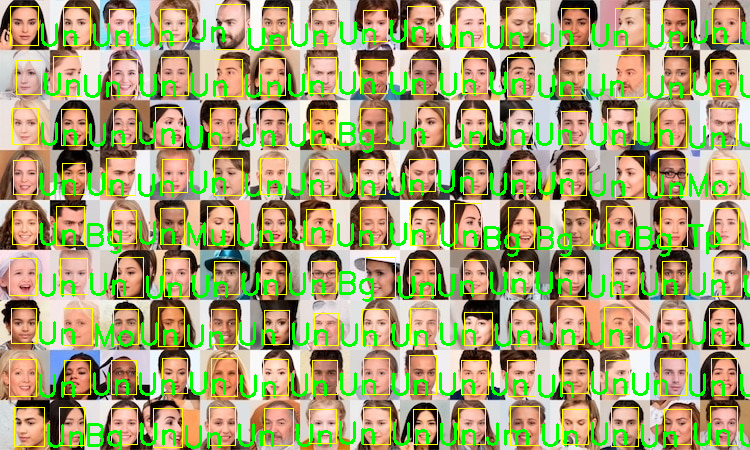

[[1.6049733e-05 7.5370920e-08 1.6235776e-07 4.0490427e-06 2.0561070e-07
  9.9997938e-01]]
[[0.0018735  0.9123601  0.00178165 0.04915818 0.02126682 0.01355972]]
[[0.01297293 0.00133985 0.0016923  0.00721524 0.00187103 0.9749087 ]]
[[7.8792691e-06 2.2202425e-08 5.6683984e-08 1.6748133e-06 6.5432040e-08
  9.9999022e-01]]
[[2.6457813e-03 1.3846625e-04 2.5309852e-04 1.4011359e-03 2.6650005e-04
  9.9529499e-01]]
[[2.6373311e-07 1.2774985e-10 5.2363502e-10 3.9774438e-08 6.1522187e-10
  9.9999964e-01]]
[[5.9229945e-04 9.5317334e-01 5.7462708e-04 2.7943583e-02 1.1150278e-02
  6.5657622e-03]]
[[0.06526936 0.16916135 0.08042313 0.09862107 0.3144195  0.27210557]]
[[2.3385907e-04 4.4457483e-06 7.7457698e-06 9.0522997e-05 9.2904393e-06
  9.9965417e-01]]


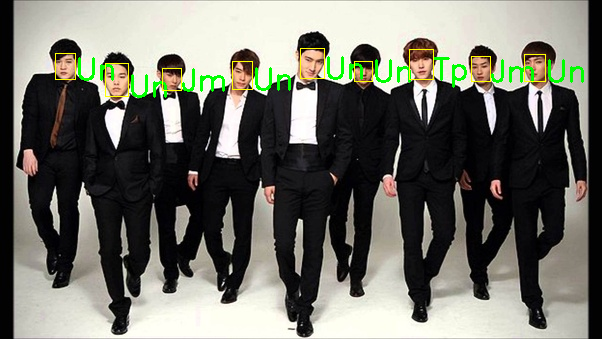

[[2.9034259e-06 5.5702141e-09 1.6137207e-08 5.8868096e-07 1.8455509e-08
  9.9999654e-01]]
[[6.2691671e-04 1.8171255e-05 3.5572233e-05 2.7452895e-04 3.7105507e-05
  9.9900764e-01]]
[[4.4604786e-08 1.1910569e-11 4.4827409e-11 5.3157421e-09 6.2390731e-11
  1.0000000e+00]]
[[0.16283493 0.10978269 0.10815347 0.14876343 0.11555949 0.354906  ]]
[[1.5688506e-07 6.5379056e-11 2.6853642e-10 2.1231537e-08 3.0802949e-10
  9.9999988e-01]]
[[2.5949175e-03 1.5255548e-04 2.3749164e-04 1.3231989e-03 2.5737859e-04
  9.9543446e-01]]
[[0.11453088 0.09594233 0.07333324 0.1307557  0.08225922 0.50317866]]
[[0.05182824 0.01341457 0.05158219 0.04302401 0.02164116 0.8185099 ]]
[[1.15896728e-05 4.22148716e-08 1.29376375e-07 3.02014519e-06
  1.16658754e-07 9.99985099e-01]]
[[2.2870065e-05 1.2990866e-07 3.3049554e-07 6.2504205e-06 3.4477384e-07
  9.9997008e-01]]
[[1.6618372e-06 2.4364268e-09 7.2081141e-09 3.0745326e-07 9.0714014e-09
  9.9999797e-01]]
[[3.22706474e-05 1.81837223e-07 6.45716796e-07 1.01260175e-05
  

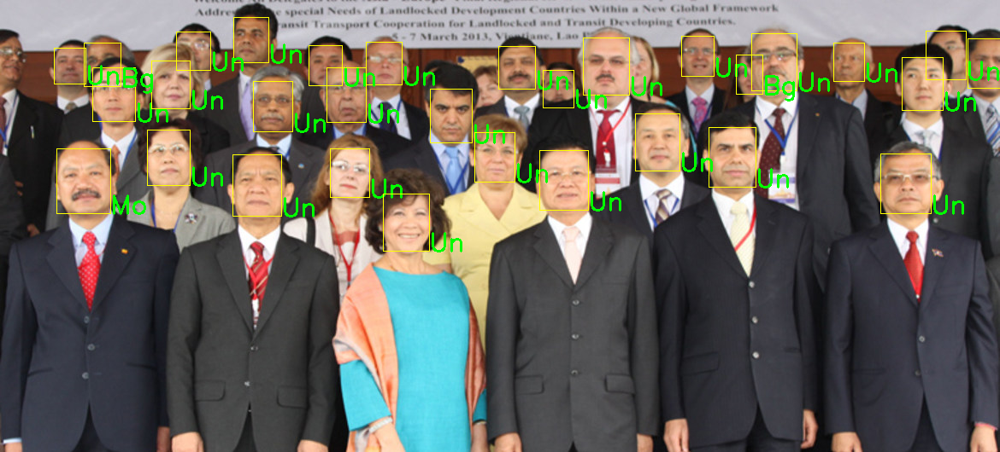

[[0.14756496 0.1481872  0.12772799 0.13697681 0.22806665 0.21147639]]
[[5.6742476e-03 5.0540816e-04 6.9095474e-04 3.2869948e-03 7.4080384e-04
  9.8910159e-01]]
[[0.00344541 0.86427116 0.00410697 0.05846417 0.04538101 0.02433128]]
[[2.4808162e-09 1.5285233e-13 6.4739815e-13 1.9523275e-10 1.0749569e-12
  1.0000000e+00]]
[[2.3936423e-07 1.5104695e-10 3.9644282e-10 3.3702221e-08 5.8324634e-10
  9.9999976e-01]]
[[4.4393525e-04 9.3435146e-06 2.6855290e-05 2.1678182e-04 1.9475432e-05
  9.9928373e-01]]
[[5.4153429e-07 4.7148019e-10 1.6333195e-09 8.8615856e-08 1.9401885e-09
  9.9999940e-01]]
[[2.07897610e-09 1.11567744e-13 6.06600978e-13 1.60065947e-10
  8.68056061e-13 1.00000000e+00]]
[[3.92843758e-05 3.01585430e-07 6.58255317e-07 1.22813435e-05
  7.41063900e-07 9.99946713e-01]]
[[2.1426715e-06 3.6478862e-09 9.9122959e-09 4.0814280e-07 1.3834048e-08
  9.9999738e-01]]
[[1.1132042e-04 1.4147223e-06 2.6745311e-06 3.8525242e-05 3.2219434e-06
  9.9984276e-01]]
[[8.810721e-09 9.905177e-13 4.729093e-

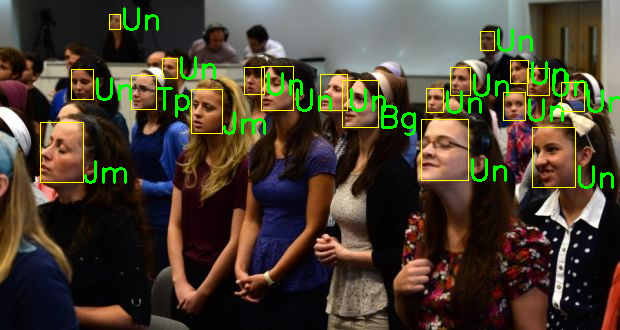

[[0.04744271 0.0157838  0.01470241 0.04590156 0.01733092 0.85883856]]


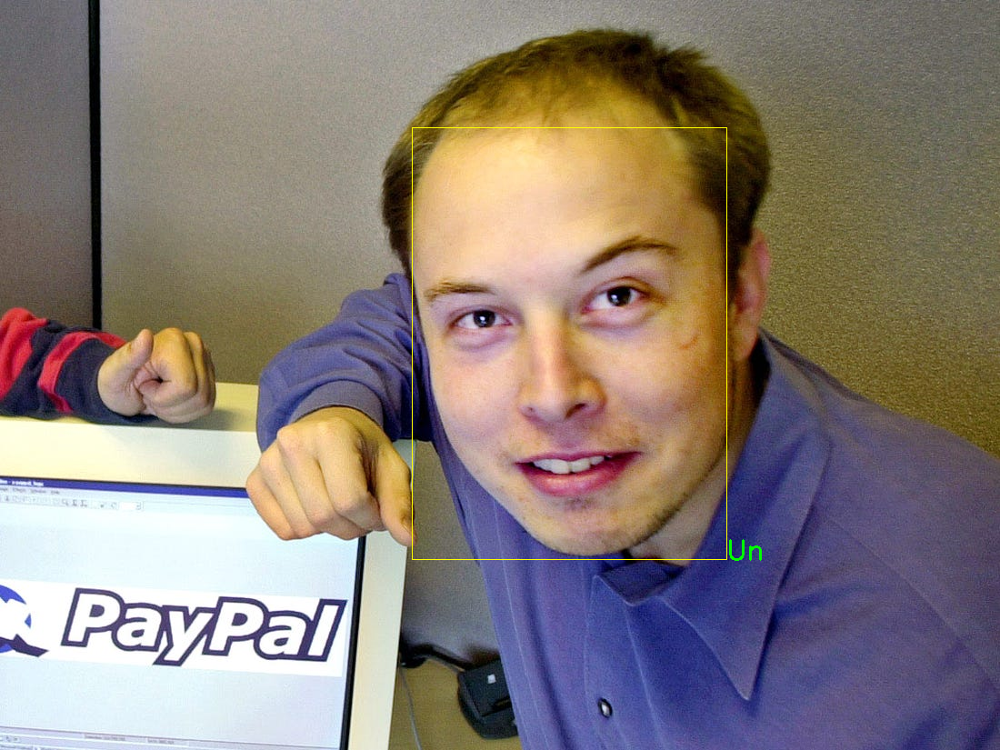

[[1.8856284e-06 1.2238167e-05 6.7087669e-09 9.9996591e-01 7.0645513e-08
  1.9940675e-05]]


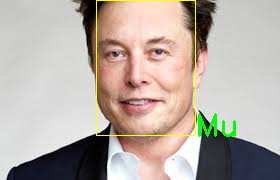

[[1.0775912e-09 3.2387636e-06 1.7055102e-07 1.4674030e-06 9.9999332e-01
  1.8179067e-06]]


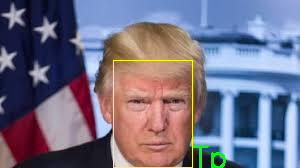

[[1.3498151e-17 2.6221781e-21 1.0000000e+00 1.3060129e-23 1.3401704e-12
  9.0314210e-16]]


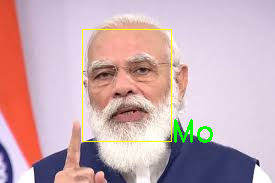

[[0.3392819  0.21605182 0.11128182 0.10603072 0.08040221 0.14695156]]


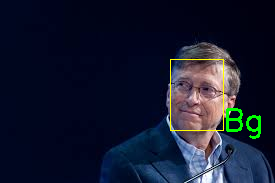

[[0.0040494  0.8661199  0.00348366 0.07426418 0.02899812 0.02308463]]


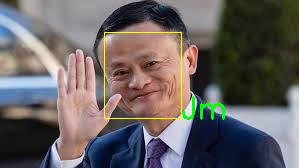

[[1.38682907e-07 9.99259174e-01 1.16607985e-07 6.50652393e-04
  7.03537444e-05 1.95867106e-05]]
[[0.02831477 0.00515171 0.00605275 0.01744156 0.00709695 0.93594223]]


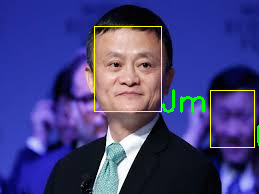

[[1.8327952e-08 2.1173337e-05 1.3486248e-06 1.0745722e-05 9.9995613e-01
  1.0611034e-05]]


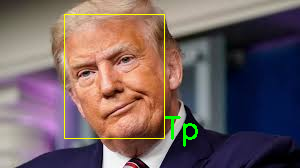

[[8.1747968e-09 9.9976319e-01 4.2755555e-09 2.2908342e-04 5.7091202e-06
  2.0372088e-06]]


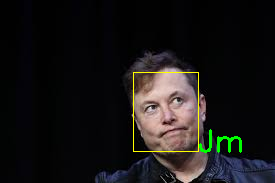

[[4.5360613e-07 3.2015516e-06 9.0800939e-10 9.9998915e-01 1.0693891e-08
  7.1353115e-06]]
[[9.9992144e-01 9.5134482e-07 3.5745386e-05 6.8576213e-07 6.2780168e-07
  4.0507108e-05]]


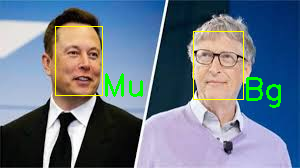

[[1.4337536e-05 1.1576494e-03 2.0744905e-04 7.4196648e-04 9.9704832e-01
  8.3037204e-04]]
[[9.9961156e-01 8.1102344e-06 1.7332539e-04 5.8134333e-06 5.5667028e-06
  1.9575734e-04]]


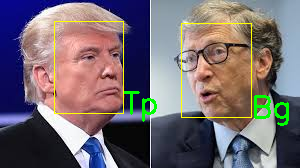

[[9.1931802e-11 5.7300302e-13 9.9999988e-01 2.3842973e-14 8.6077250e-08
  1.1624911e-09]]
[[0.01843402 0.07709367 0.04448074 0.06705853 0.7230241  0.06990892]]


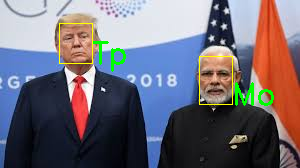

[[0.01693589 0.00449985 0.00461917 0.03162044 0.00404679 0.9382779 ]]
[[0.12738155 0.06409834 0.0684097  0.10721008 0.07357993 0.5593204 ]]


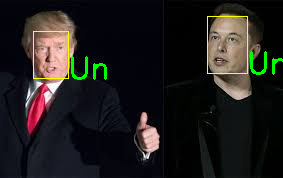

[[9.3278089e-05 9.8160237e-01 7.2350442e-05 1.3820664e-02 2.7948541e-03
  1.6165883e-03]]
[[4.4263702e-14 6.5294139e-09 8.5063422e-11 1.8952451e-09 1.0000000e+00
  2.4745166e-09]]


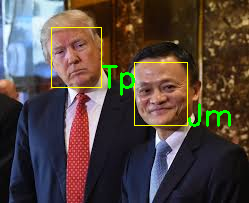

[[3.3913314e-10 9.9995613e-01 2.1803187e-10 4.2288459e-05 1.2329109e-06
  2.7426401e-07]]
[[1.1755760e-04 5.5738742e-04 3.7013567e-06 9.9881810e-01 2.9478328e-05
  4.7376411e-04]]


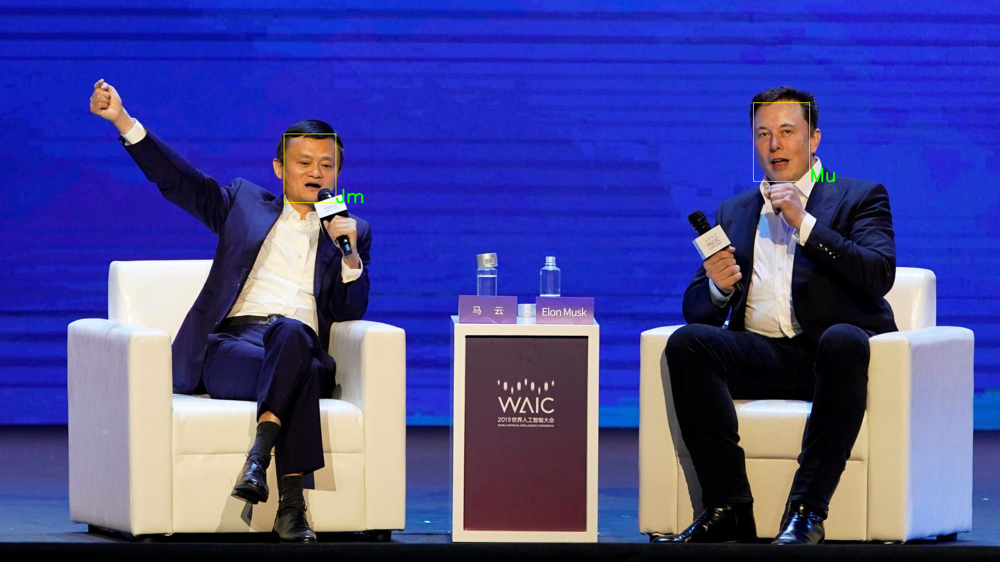

[[7.1087450e-12 9.9999189e-01 3.2598518e-12 7.9604688e-06 7.3534238e-08
  1.7444936e-08]]
[[2.2975877e-07 7.8734823e-09 9.9997699e-01 1.0136508e-09 2.1515056e-05
  1.2894403e-06]]


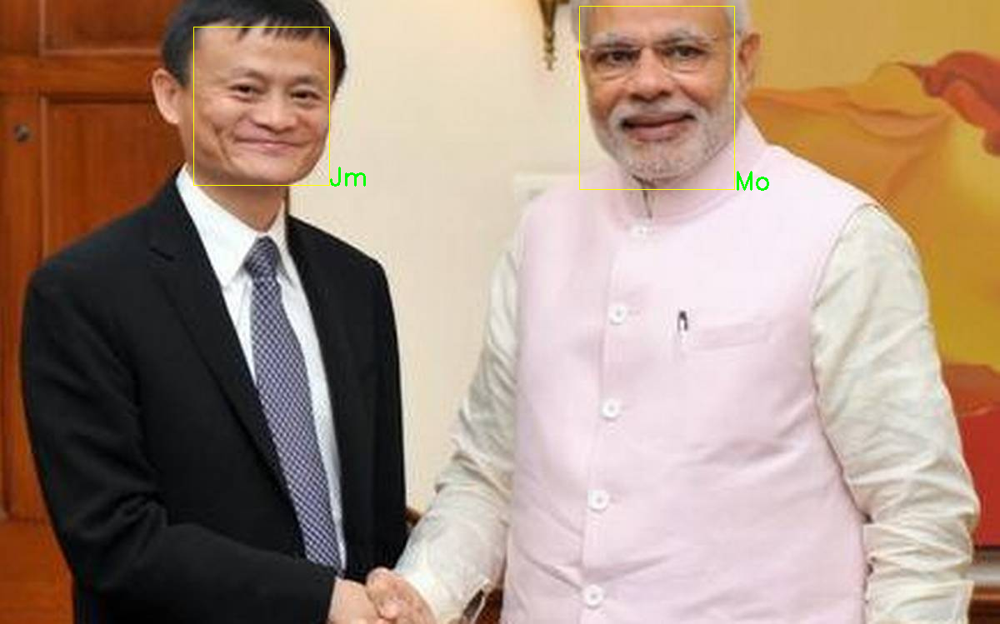

[[1.0000000e+00 1.6339591e-13 3.6584993e-10 8.5178724e-14 7.2259222e-14
  4.6566417e-10]]
[[8.9419086e-07 4.3625970e-08 9.9993861e-01 6.6361325e-09 5.6381126e-05
  4.0922314e-06]]


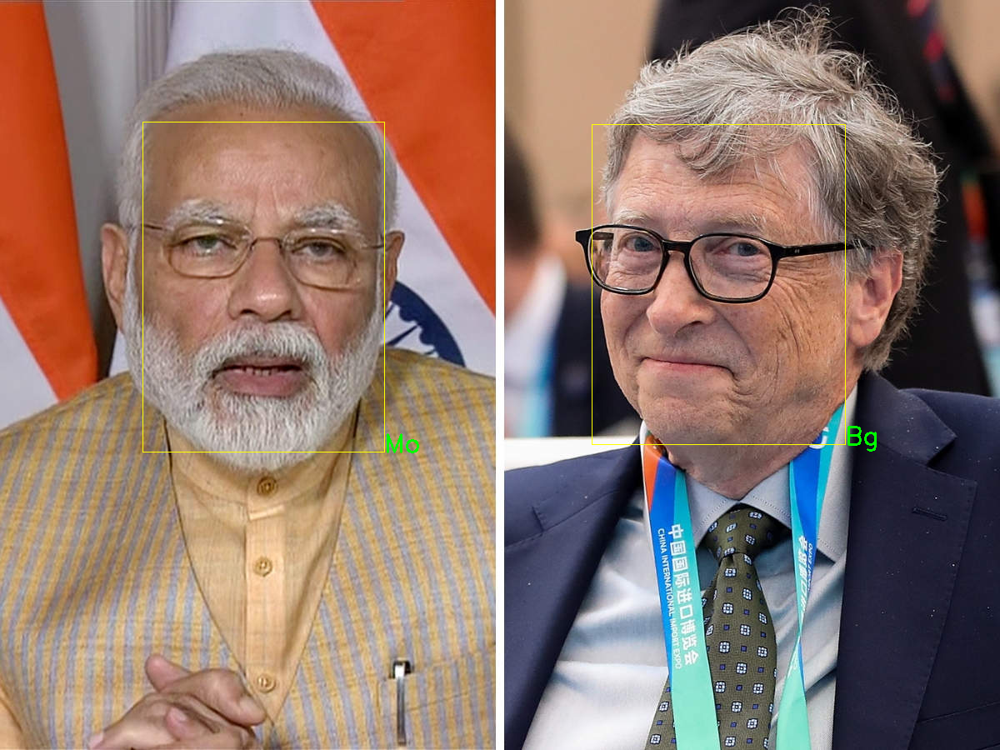

[[5.8516672e-09 6.4006927e-13 2.4599203e-12 5.2842092e-10 3.6450456e-12
  1.0000000e+00]]
[[2.9658896e-08 6.7578655e-12 2.5660496e-11 3.4491896e-09 3.7476355e-11
  1.0000000e+00]]
[[0.15043522 0.13258548 0.1849255  0.14886253 0.15250622 0.23068504]]
[[0.05069923 0.5046886  0.04586108 0.16840164 0.1179786  0.11237086]]
[[0.07030673 0.40241405 0.06904718 0.1679834  0.15016863 0.14008   ]]
[[0.01165912 0.00144028 0.00243016 0.00762114 0.00220292 0.9746464 ]]
[[2.0134645e-04 3.3877509e-06 7.2587964e-06 7.8496370e-05 7.6187193e-06
  9.9970180e-01]]
[[4.3994482e-04 1.0351860e-05 2.1316004e-05 1.7654044e-04 2.1398126e-05
  9.9933040e-01]]
[[0.01367622 0.00186453 0.00277955 0.00932217 0.00279235 0.96956515]]
[[8.6859193e-11 1.1215330e-15 6.2318056e-15 4.5331408e-12 1.0188683e-14
  1.0000000e+00]]
[[0.03272561 0.61115324 0.02732896 0.15088297 0.08367998 0.09422928]]
[[0.55283904 0.06484387 0.11681364 0.05546324 0.06066123 0.14937899]]
[[0.06641705 0.01921334 0.03272299 0.05310965 0.02678351 0.8

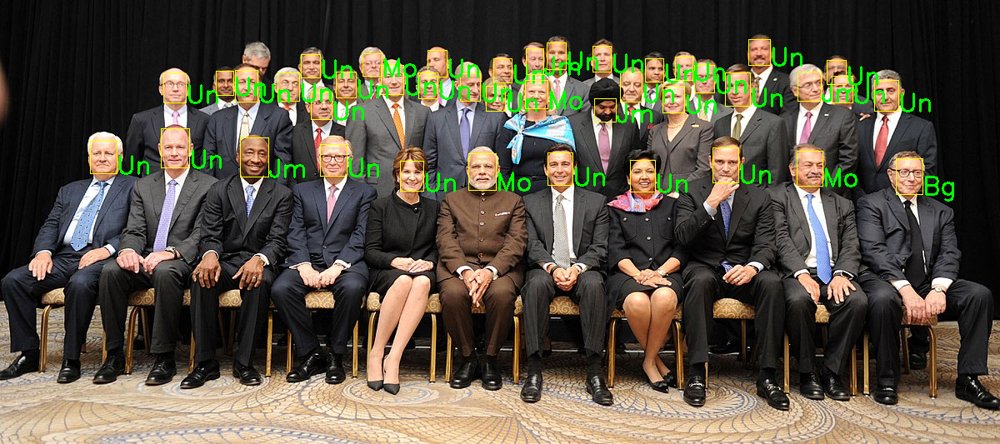

[[1.1262867e-07 5.8764192e-05 5.1197267e-06 2.8539289e-05 9.9986529e-01
  4.2159430e-05]]
[[1.2662628e-03 4.9142283e-05 7.2199698e-05 5.1743828e-04 9.2848080e-05
  9.9800211e-01]]
[[0.0472225  0.01131739 0.01270963 0.03170262 0.014393   0.8826548 ]]
[[0.13873066 0.06971676 0.07408933 0.11296651 0.08280922 0.5216875 ]]
[[0.19463797 0.12491005 0.12100589 0.15093711 0.12979227 0.2787167 ]]
[[0.16585013 0.12296253 0.11586276 0.15069969 0.12853087 0.31609398]]
[[0.01590363 0.0021114  0.00264709 0.00900583 0.0031522  0.96717983]]
[[0.09701961 0.03705444 0.0381537  0.0719318  0.04396877 0.7118716 ]]
[[0.0339739  0.00680897 0.00782874 0.02140457 0.00931613 0.92066777]]
[[0.0750714  0.02403159 0.02565863 0.05330372 0.02965261 0.79228204]]
[[0.17074122 0.13645665 0.12404753 0.15393946 0.13820396 0.27661115]]
[[0.16883287 0.13453007 0.12382974 0.15403691 0.13787748 0.28089294]]
[[0.0908069  0.03254544 0.0354851  0.06757307 0.03950468 0.7340848 ]]
[[0.02440827 0.00408572 0.00487164 0.01480893 0.00

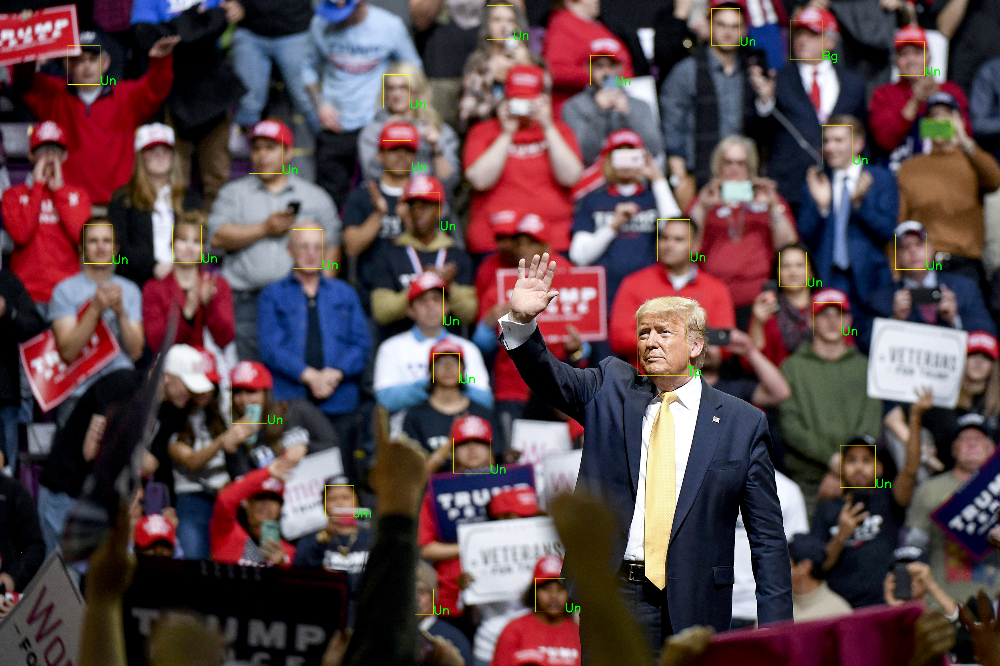

[[0.06153102 0.02014392 0.02473192 0.04868442 0.02504246 0.8198663 ]]
[[2.2909877e-05 1.3355555e-07 2.3720528e-07 5.5266478e-06 3.0431517e-07
  9.9997079e-01]]
[[1.9918009e-05 1.0391702e-07 2.8781395e-07 5.5489099e-06 2.8959172e-07
  9.9997389e-01]]
[[0.0313061  0.53930813 0.04020191 0.098932   0.16881083 0.12144107]]
[[0.01814501 0.6688546  0.02080153 0.10872363 0.1125424  0.07093288]]
[[9.9417342e-11 7.2956821e-13 9.9999988e-01 3.4621123e-14 9.9699292e-08
  1.3250515e-09]]
[[0.01278143 0.00153843 0.00197799 0.00751959 0.00207564 0.97410685]]
[[7.8794757e-17 1.2251025e-10 7.2669073e-13 2.7269490e-11 1.0000000e+00
  4.3954836e-11]]
[[2.9761435e-10 6.4596909e-15 4.0303173e-14 1.7382311e-11 5.7104983e-14
  1.0000000e+00]]
[[7.9658837e-04 2.3790626e-05 4.0105868e-05 3.5847860e-04 4.1675677e-05
  9.9873942e-01]]
[[2.4661043e-04 4.1778444e-06 2.5396121e-05 1.0943876e-04 9.6626773e-06
  9.9960476e-01]]
[[0.01897332 0.09861049 0.04398358 0.06235156 0.6991335  0.07694753]]
[[4.0160009e-09 3.44

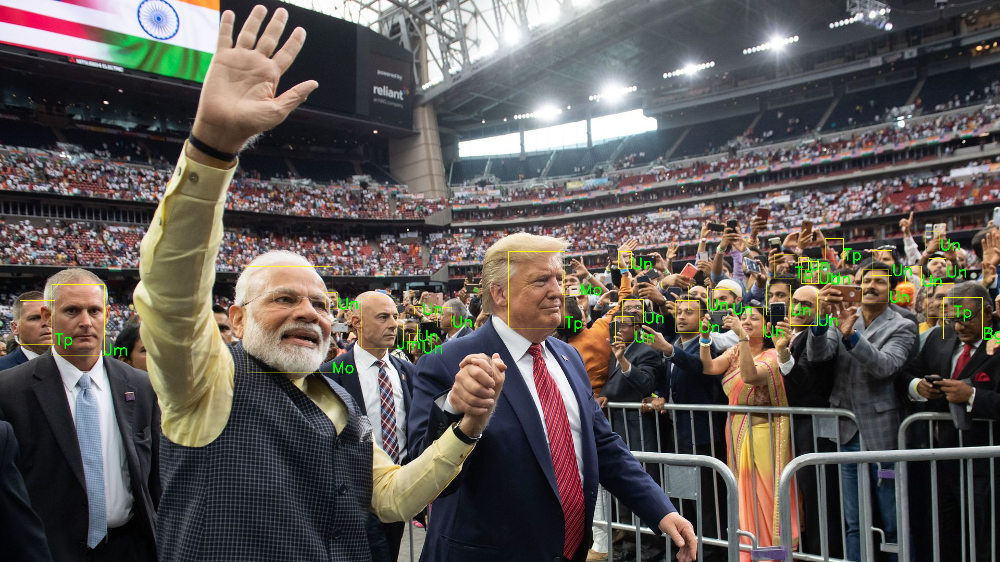

[[2.4181789e-05 1.3842812e-07 3.0821562e-07 6.7038109e-06 3.7530356e-07
  9.9996829e-01]]
[[1.2918176e-06 1.9041304e-09 5.5883258e-09 2.5256514e-07 6.9706809e-09
  9.9999845e-01]]
[[1.5922835e-09 9.2519207e-14 3.5601378e-13 1.1690925e-10 5.8079670e-13
  1.0000000e+00]]
[[0.02243623 0.00326702 0.02485999 0.01725247 0.0070063  0.92517805]]
[[6.1329606e-06 1.8623112e-08 5.3150046e-08 1.4730213e-06 5.9512061e-08
  9.9999237e-01]]
[[3.9744755e-04 8.5811134e-06 1.7531904e-05 1.6001762e-04 1.6888220e-05
  9.9939954e-01]]
[[2.0404836e-10 4.3148841e-15 2.0185505e-14 1.1411649e-11 3.4437971e-14
  1.0000000e+00]]
[[7.6463893e-06 2.5248733e-08 7.1699979e-08 1.9348631e-06 8.2985338e-08
  9.9999022e-01]]
[[6.7824362e-06 1.0059034e-06 9.9943298e-01 3.1627536e-07 4.0852820e-04
  1.5041501e-04]]
[[0.1564229  0.1878104  0.13715698 0.15496877 0.1665256  0.19711536]]
[[8.5966999e-04 2.7724591e-05 4.8775859e-05 3.8522042e-04 5.5669734e-05
  9.9862289e-01]]
[[1.4220961e-07 5.8635936e-11 2.2660009e-10 1.8679

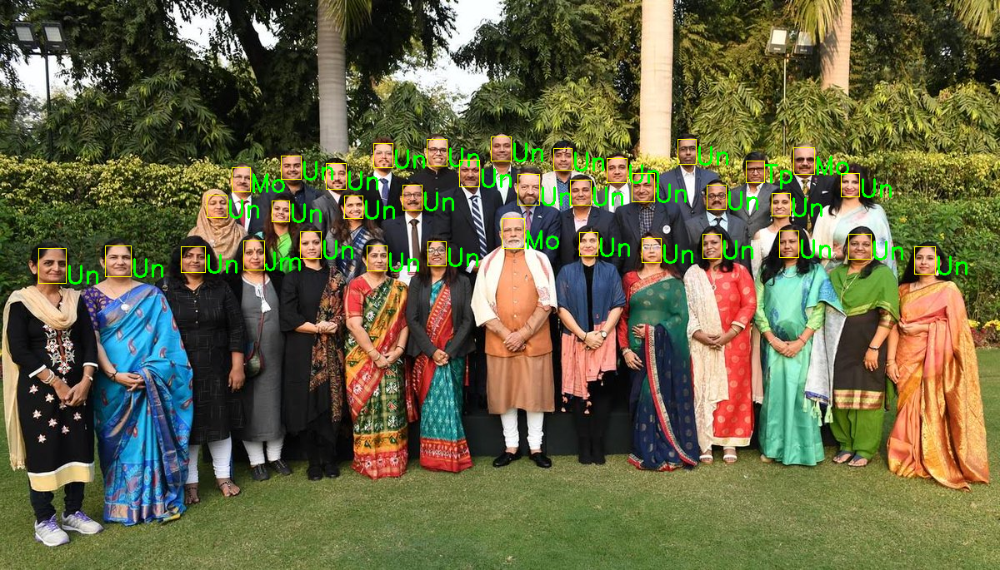

[[2.9704834e-05 2.2004113e-07 6.9790616e-07 1.0458888e-05 5.8679478e-07
  9.9995828e-01]]
[[1.0678337e-07 4.5614866e-11 1.2781398e-10 1.3083290e-08 2.0537158e-10
  9.9999988e-01]]
[[0.01105995 0.77082866 0.01016978 0.1073318  0.05523003 0.04537968]]
[[4.2677889e-04 8.5145541e-05 9.9354786e-01 2.9944358e-05 4.6835053e-03
  1.2267840e-03]]
[[3.5783218e-03 2.2924946e-04 4.6337099e-04 2.0664914e-03 4.2190828e-04
  9.9324071e-01]]
[[0.00955163 0.00118248 0.00215109 0.00682946 0.00179634 0.97848904]]
[[0.05293678 0.01329666 0.02605603 0.04226337 0.01894816 0.8464989 ]]
[[0.03123391 0.00649326 0.00942138 0.02303508 0.00819494 0.9216215 ]]
[[0.58317924 0.06287481 0.11340652 0.05744656 0.0602432  0.1228497 ]]
[[0.12333269 0.10792104 0.0816186  0.1485249  0.08296597 0.4556368 ]]
[[0.07542574 0.02954035 0.22123413 0.06993676 0.05410877 0.5497542 ]]
[[1.3247582e-03 5.3296335e-05 8.3119070e-05 5.8903580e-04 9.3715491e-05
  9.9785608e-01]]
[[0.01953306 0.00312988 0.00453159 0.01277391 0.00431573 0.9

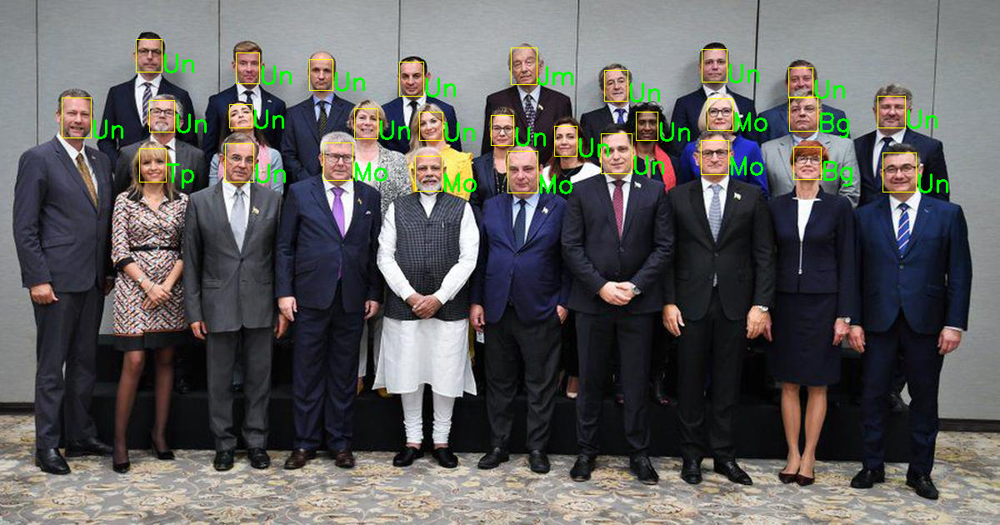

In [ ]:
for j in range(len(list(new_images.glob('00/*.jpg')))):
  path = str(list(new_images.glob('00/*.jpg'))[j])
  Face_recognition(path)

Predicting the faces with png type Format Images

[[2.8115007e-06 5.6507719e-09 1.3037537e-08 5.2692587e-07 1.7502311e-08
  9.9999666e-01]]
[[1.6525240e-08 2.6797338e-12 1.0700479e-11 1.7832593e-09 1.5160167e-11
  1.0000000e+00]]
[[1.3141951e-14 2.6060434e-21 2.4219577e-20 2.2234080e-16 4.8878623e-20
  1.0000000e+00]]
[[2.1460783e-03 1.4317439e-04 1.5742860e-04 1.0524075e-03 1.8593087e-04
  9.9631506e-01]]
[[4.0586133e-06 8.8544967e-09 2.5662320e-08 8.5288349e-07 3.2855681e-08
  9.9999511e-01]]
[[0.02030083 0.69346166 0.01763597 0.13204278 0.07190703 0.06465176]]
[[1.6578312e-07 7.0835622e-11 3.0773051e-10 2.3686438e-08 3.4060715e-10
  9.9999976e-01]]
[[1.6324368e-08 2.8286898e-12 9.4825398e-12 1.5979484e-09 1.4674638e-11
  1.0000000e+00]]
[[3.5965474e-18 1.1894087e-26 2.2635346e-25 2.1355609e-20 5.5625437e-25
  1.0000000e+00]]
[[1.5423819e-04 2.0710172e-06 4.7184285e-06 5.1692794e-05 5.2954620e-06
  9.9978203e-01]]
[[3.81655276e-08 1.04419615e-11 3.00212251e-11 4.17061541e-09
  4.76210599e-11 1.00000000e+00]]
[[8.2348442e-06 3.342889

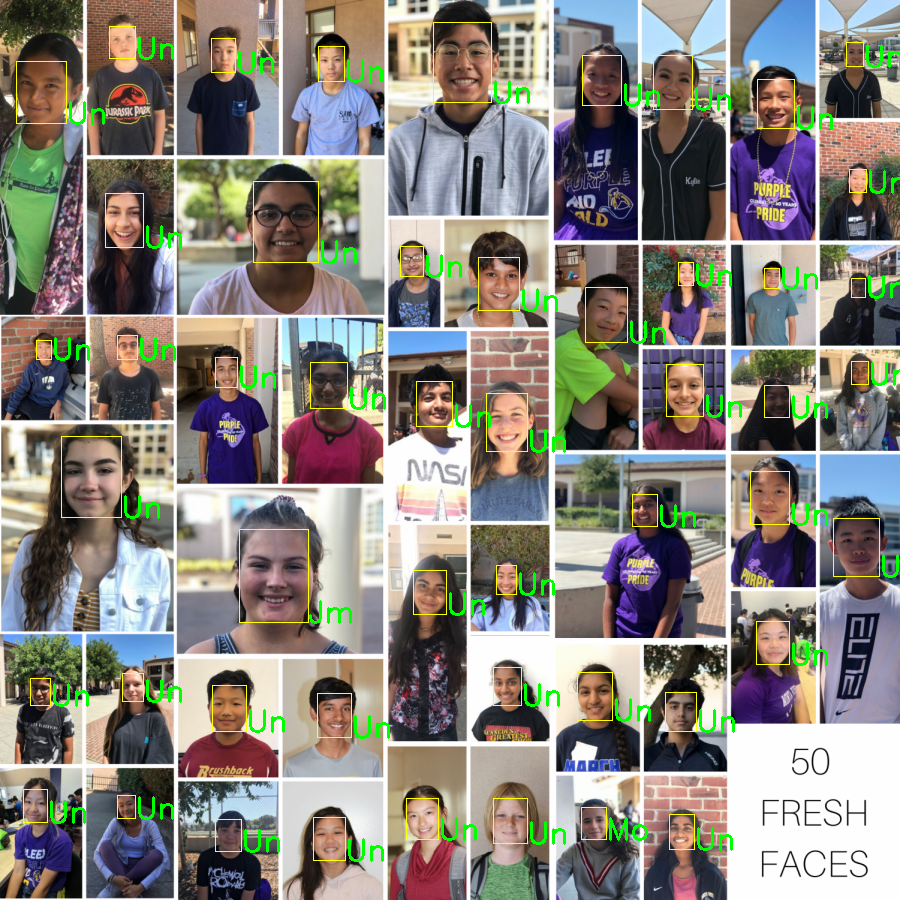

[[1.0375457e-14 1.6332482e-21 1.4714201e-20 1.4944920e-16 3.3305762e-20
  1.0000000e+00]]
[[3.8226382e-08 9.9958116e-01 2.3910603e-08 3.9308475e-04 1.8616724e-05
  7.1495683e-06]]
[[7.7024888e-04 2.3508564e-05 3.7086411e-05 3.5166348e-04 4.4893484e-05
  9.9877256e-01]]
[[0.12180594 0.12004461 0.10763992 0.15791559 0.10125693 0.39133695]]
[[6.7283150e-07 4.9474819e-10 1.8211992e-09 1.1071750e-07 2.3247155e-09
  9.9999917e-01]]
[[0.13769247 0.21559311 0.10027081 0.18658046 0.10458695 0.25527623]]
[[2.8259930e-04 7.3075159e-03 1.9291475e-03 4.1396110e-03 9.7988933e-01
  6.4519020e-03]]
[[0.1062341  0.05073244 0.0520149  0.07790849 0.07942592 0.6336842 ]]
[[1.1671040e-08 1.7432071e-12 5.6328115e-12 1.0809642e-09 9.1676822e-12
  1.0000000e+00]]
[[1.4226950e-14 2.3092667e-21 2.5912050e-20 2.3154474e-16 5.0750361e-20
  1.0000000e+00]]
[[7.1069179e-12 2.9577864e-17 1.5797993e-16 2.7293453e-13 3.1286859e-16
  1.0000000e+00]]
[[8.7741121e-09 1.0945309e-12 4.1898963e-12 9.1615560e-10 5.9657752e-1

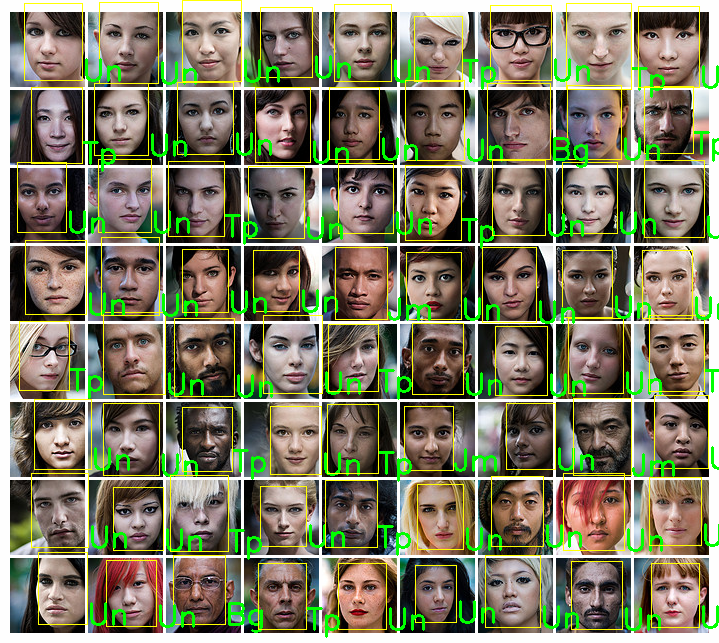

In [ ]:
for j in range(len(list(new_images.glob('00/*.png')))):
  path = str(list(new_images.glob('00/*.png'))[j])
  Face_recognition(path)